## Github Setup
If not already present this clones the repo into google colab so that I may work on it with a bash environment.

In [0]:
from getpass import getpass
import os

!git config --global user.name "Richard Boyne"
!git config --global user.email "boynerichard@yahoo.co.uk"

# if not in a repo clone the desired one
if not os.path.isdir(".git"):
    
    # get username and password
    user = "Boyne272"
    password = getpass('github password')
    os.environ['GITHUB_AUTH'] = user + ':' + password
    
    # clone the repo
    !git clone https://$GITHUB_AUTH@github.com/msc-acse/acse-9-independent-research-project-Boyne272.git repo

    # move the repo directory up one
    !mv repo/.git .
    
    # swap to the wanted branch
    !git checkout merging
    
    # move to previous commit
    !git reset --hard
    
# remove the sample data if there
if os.path.isdir("sample_data"):
    !rm -r sample_data/

# remove the tmp repo folder if there
if os.path.isdir("repo"):    
    !rm -r repo
    
# show where we are
!git show --summary

github password··········
Cloning into 'repo'...
remote: Enumerating objects: 176, done.
remote: Counting objects: 100% (176/176), done.
remote: Compressing objects: 100% (127/127), done.
remote: Total 176 (delta 87), reused 116 (delta 43), pack-reused 0
Receiving objects: 100% (176/176), 40.22 MiB | 18.82 MiB/s, done.
Resolving deltas: 100% (87/87), done.
D	.gitignore
D	Peliminary Report Richard Boyne.pdf
D	Thin_Sections_Workspace.ipynb
D	images/MSLIC_comparisons/MSLIC_both_1600k_10i.jpg
D	images/MSLIC_comparisons/MSLIC_polar_1600k_10i.jpg
D	images/MSLIC_comparisons/MSLIC_white_1600k_10i.jpg
D	images/MSLIC_comparisons/SLIC_polar_1600k_10i.jpg
D	images/MSLIC_comparisons/SLIC_white_1600k_10i.jpg
D	images/TX1_polarised_cropped.tif
D	images/TX1_white_cropped.tif
D	kmeans/Kmeans_Examples.ipynb
D	kmeans/MSLIC.py
D	kmeans/SLIC.py
D	kmeans/kmeans_basic.py
D	kmeans/kmeans_examples.ipynb
D	kmeans/kmeans_img.py
D	kmeans/kmeans_local.py
D	kmeans/kmeans_local_failed.py
D	kmeans/kmeans_multi_fail.p

## Github Space
Use the cells here to run github commands

In [0]:
!mv tmp.txt /content/identification/recombination_wrapper.py

In [16]:
!git status

On branch merging
Your branch is up to date with 'origin/merging'.

Untracked files:
  (use "git add <file>..." to include in what will be committed)

	identification/recombination_wrapper.py

nothing added to commit but untracked files present (use "git add" to track)


In [0]:
!git add identification/recombination_wrapper.py

In [18]:
!git commit -m "Created reombination wrapper to handel the clustering and combination of segements" -m "Tuning the choice of texture color features and hyper parameters is still a big task but now the infrastructure is here"

[merging f381b97] Created reombination wrapper to handel the clustering and combination of segements
 1 file changed, 567 insertions(+)
 create mode 100644 identification/recombination_wrapper.py


In [19]:
!git push origin merging

Counting objects: 4, done.
Delta compression using up to 2 threads.
Compressing objects: 100% (4/4), done.
Writing objects: 100% (4/4), 5.69 KiB | 5.69 MiB/s, done.
Total 4 (delta 2), reused 0 (delta 0)
remote: Resolving deltas: 100% (2/2), completed with 2 local objects.
To https://github.com/msc-acse/acse-9-independent-research-project-Boyne272.git
   a4ce554..f381b97  merging -> merging


## Manual Testing
Pytest test code to run all locatable tests. Note that Each test is inself a unittest so can bedone by running each test file indevidually aswell.

In [0]:
!py.test # last ran 30/07

============================= test session starts ==============================
platform linux2 -- Python 2.7.15+, pytest-3.6.4, py-1.8.0, pluggy-0.7.1
rootdir: /content, inifile:
collected 19 items                                                             

identification/test_basic_heirachical_clustering.py ..                   [ 10%]
kmeans/test_MSLIC.py ...                                                 [ 26%]
kmeans/test_SLIC.py ....                                                 [ 47%]
kmeans/test_kmeans_basic.py .                                            [ 52%]
kmeans/test_kmeans_img.py ..                                             [ 63%]
kmeans/test_kmeans_local.py ....                                         [ 84%]
kmeans/test_kmeans_local_failed.py ...                                   [100%]

========================== 19 passed in 62.17 seconds ==========================


## Imports

In [0]:
# Ipython magic functions
%load_ext autoreload
%autoreload 2
%matplotlib inline

# path extensions
import sys
sys.path.insert(0, "/content/kmeans")
sys.path.insert(0, "/content/identification")

In [0]:
# imports
import torch
import matplotlib.pyplot as plt
import numpy as np
import scipy.signal as sig
from skimage import morphology

# custom imports
from tools import set_seed, get_img, progress_bar
# from basic_heirachical_clustering import basic_heirachical_clustering
from SLIC import SLIC
from MSLIC import MSLIC_wrapper

## Development Space

### Preprocessing

In [0]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

class preprocessing():
    
    def __init__(self, path, **kwargs):
        
        # load the image
        self._orig_path = path
        self.img = cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)
        self.log = 'Orig Img'
        
        # set defualt parameters and user choices 
        self.params = {'figsize':[22, 22], 'sig_col':75, 'sig_space':75,
                       'kernal_guass':(5, 5), 'kernal_median':5,
                       'kernal_bilateral':5, 'erode_iterations':1,
                       'kernal_erode':np.ones([5,5], dtype=np.uint8),
                       'dilate_iterations':1,
                       'kernal_dilate':np.ones([5,5], dtype=np.uint8)}
        self.set_param(**kwargs)
        
        
    def set_param(self, **kwargs):
        # set any custom params
        for key, val in kwargs.items():
            if key in self.params.keys():
                self.params[key] = val
                print(key, ' set to ', val)
        
        
    def save_as_img(self, path):
        cv2.imwrite(path, self.img)
        
        
    def save_as_array(self, new_path):
        np.save(path, self.img)
        
        
    def normalise(self):
        self.img = cv2.normalize(self.img, None, alpha=0, beta=1,
                                 norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        
        
    def show(self):
        plt.figure(figsize=self.params['figsize'])
        plt.imshow(self.img)
        plt.title(self.log)
        
        
    def change_color_space(self, flag=cv2.COLOR_BGR2HSV):
        self.img = cv2.cvtColor(self.img, cv2.COLOR_BGR2HSV)
        self.log += ', C Space Transform'
        
        
    def apply(self, *args):
        
        # options in order
        for arg in args:
            if 'guass' == arg:
                k = self.params['kernal_guass']
                self.img = cv2.GaussianBlur(self.img, k, 0)
                self.log += ', guass (' + str(k) + ')'

            if 'median' == arg:
                k = self.params['kernal_median']
                self.img = cv2.medianBlur(self.img, k)
                self.log += ', median (' + str(k) + ')'

            if 'bilateral' == arg:
                k = self.params['kernal_bilateral']
                self.img = cv2.bilateralFilter(self.img, k, self.params['sig_col'],
                                               self.params['sig_space'])
                self.log += ', bilateral (' + str(k) + ')'

            if 'erode' == arg:
                self.img = cv2.erode(self.img, self.params['kernal_erode'],
                                     iterations=self.params['erode_iterations'])
                self.log += ', erode'

            if 'dilate' == arg:
                self.img = cv2.dilate(self.img, self.params['kernal_dilate'],
                                      iterations=self.params['dilate_iterations'])
                self.log += ', dilate'

### basic_heirachical_clustering

Progress |###################################################| 0.3017 s

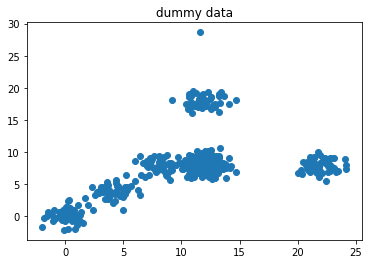

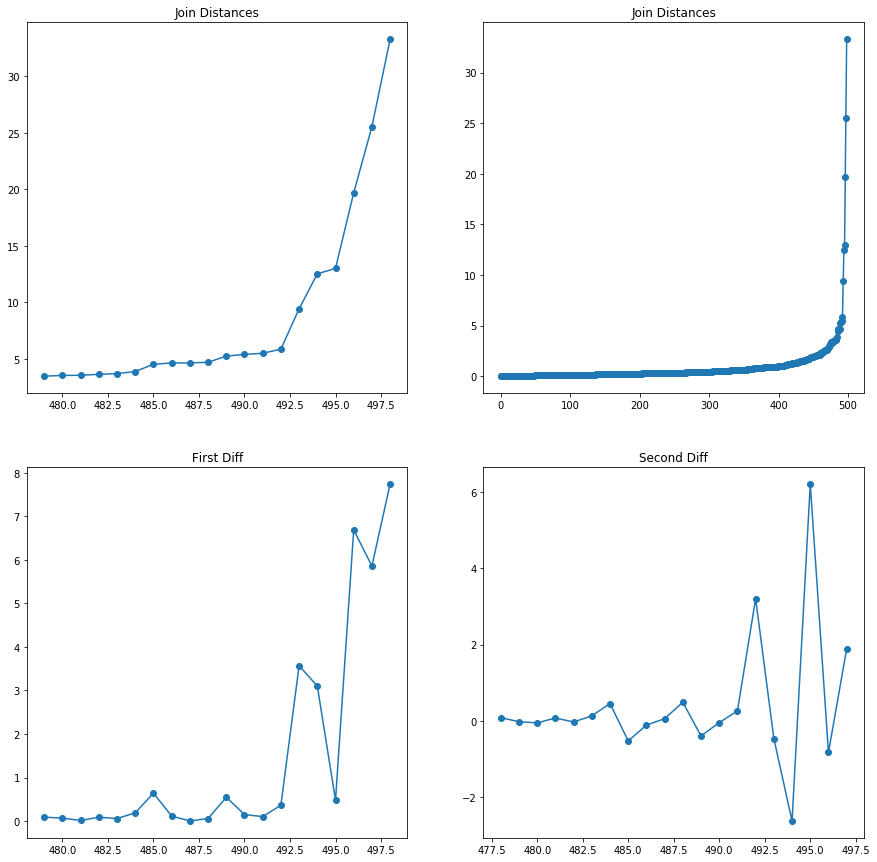

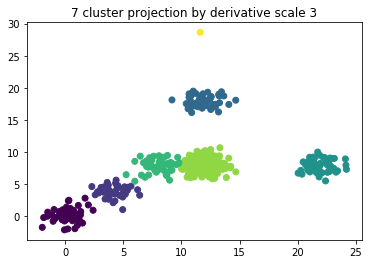

In [0]:
import numpy as np
import matplotlib.pyplot as plt
from tools import progress_bar

class basic_heirachical_clustering():
    
    def __init__(self, features, join_by='max'):
        
        # logs which track merges and there distances
        self.dist_log = []
        self.merge_log = []
        
        # vectors
        self._vecs = features.copy()
        self._N = features.shape[0]
        self._group_count = self._N
        
        # find distances between every vector
        self._dists = np.full((self._N, self._N), np.inf)
        for _id in range(self._N):
            self._find_distance(_id)
                               
        # option of distance recaulculation
        if join_by == 'max':
            self._join = self._join_by_max
        elif join_by == 'min':
            self._join = self._join_by_min
        else:
            raise(ValueError)
    
        
    def _calc_dist(self, vec, vec_array):
            return np.sqrt(((vec - vec_array)**2).sum(axis=1))

        
    def _find_distance(self, _id):
        "Calculte the distance between this vector and all others"
        
        # find distance to every point before this id
        self._dists[_id, :_id] = self._calc_dist(self._vecs[_id],
                                                 self._vecs[:_id])
        
        # find the distance to every pstdoint after this id
        self._dists[_id+1:, _id] = self._calc_dist(self._vecs[_id],
                                                   self._vecs[_id+1:])
        return
        
        
    def _join_by_min(self, id1, id2):
        
        # find the minimum of the two distances
        dists_id1 = np.hstack([self._dists[id1, :id1], self._dists[id1:, id1]])
        dists_id2 = np.hstack([self._dists[id2, :id2], self._dists[id2:, id2]])
        dists_min = np.minimum(dists_id1, dists_id2)
        
        # make merging points inf distance apart
        dists_min[id1] = dists_min[id2] = np.inf
        
        # set the id1 distances to the min_distances
        self._dists[id1, :id1] = dists_min[:id1]
        self._dists[id1:, id1] = dists_min[id1:]
        
        # set the id2 distances to inf
        self._dists[id2, :id2] = self._dists[id2:, id2] = np.inf
    
    
    def _join_by_max(self, id1, id2):
        
        # find the minimum of the two distances
        dists_id1 = np.hstack([self._dists[id1, :id1], self._dists[id1:, id1]])
        dists_id2 = np.hstack([self._dists[id2, :id2], self._dists[id2:, id2]])
        dists_max = np.maximum(dists_id1, dists_id2)
        
        # set the id1 distances to the min_distances
        self._dists[id1, :id1] = dists_max[:id1]
        self._dists[id1:, id1] = dists_max[id1:]
        
        # set the id2 distances to inf
        self._dists[id2, :id2] = self._dists[id2:, id2] = np.inf
        
        
    def iterate(self):
        
        iterate = self._group_count-1
        
        bar = progress_bar(iterate) # verbose
        
        for i in range(iterate):
            
            if self._group_count == 1:
                print('\nFully merged graph\n')
                break
            
            id1, id2 = np.unravel_index(self._dists.argmin(),
                                        self._dists.shape)
            
            self.dist_log.append(self._dists[id1, id2])
            self.merge_log.append((id1, id2))
            self._group_count -= 1
            
            self._join(id1, id2)
             
            bar(i) # verbose
            
            
    def deriv_clustering(self, scale=3., plot=True):
        
        directory = dict([(n,n) for n in range(self._N)])
        # { vector id : group id }
        
        # find the second deriative cutoff
        y = np.array(self.dist_log)
        dy2 = y[:-2] - 2*y[1:-1] + y[2:] # central
        std = np.std(dy2)
        cutoff = (dy2 < (scale * std)).sum() - 1 # dont do the merge that was too far
        
        for i in range(cutoff):
            id1, id2 = self.merge_log[i]
            for key, val in directory.items():
                if val == id2:
                    directory[key] = id1
        
        groupings = np.unique(list(directory.values()), return_inverse=True)[1]
        n = len(np.unique(list(directory.values())))
        
        if plot:
            fig, ax = plt.subplots()
            ax.scatter(*self._vecs[:, :2].T, c=groupings)
            ax.set(title= str(n) + ' cluster projection by derivative scale ' 
                   + str(scale))
        
        return groupings

    
    def dist_clustering(self, cutoff=1.):
        
        directory = dict([(n,n) for n in range(self._N)])
        # { vector id : group id }
        
        for dist, pair in zip(self.dist_log, self.merge_log):
            if dist < cutoff:
                for key, val in directory.items():
                    if val == pair[1]:
                        directory[key] = pair[0]
        
        groupings = np.unique(list(directory.values()), return_inverse=True)[1]
        n = len(np.unique(list(directory.values())))
                
        if plot:
            fig, ax = plt.subplots()
            ax.scatter(*self._vecs[:, :2].T, c=groupings)
            ax.set(title= str(n) + ' cluster projection by distance cutoff '
                   + str(cutoff))
        
        return groupings

    
    
    def dist_plot(self, option, ax=None, last_few=True):

        if not ax:
            fig, ax = plt.subplots(figsize=[12, 10])
        n = 20 if last_few else self._N
        y = np.array(self.dist_log)
        
        if option == 'dists':
            x = np.arange(0, self._N-1)
            ax.plot(x[-n:], y[-n:], '-o')
            ax.set(title='Join Distances')
            
        elif option == '1st':
            x = np.arange(1, self._N-1)
            dy = y[1:] - y[:-1] # forward
            ax.plot(x[-n:], dy[-n:], '-o')
            ax.set(title='First Diff')
            
        elif option == '2nd':
            x = np.arange(1, self._N-2)
            dy2 = y[:-2] - 2*y[1:-1] + y[2:] # central
            ax.plot(x[-n:], dy2[-n:], '-o')
            ax.set(title='Second Diff')
            
        # composit option
        elif option == 'all':
            plt.close()
            fig, axs = plt.subplots(2,2, figsize=[15,15])
            self.dist_plot('dists', ax=axs[0,0])
            self.dist_plot('dists', ax=axs[0,1], last_few=False)
            self.dist_plot('1st', ax=axs[1,0])
            self.dist_plot('2nd', ax=axs[1,1])
            
        else:
            plt.close()
            print('opt not known')
            
            
if __name__ == '__main__':
    
    # generate dummy 3d data
    np.random.seed(10)
    features = np.random.normal(size=[500, 2])
    features[50:, :] += 4
    features[100:, :] += 4
    features[150:, 0] += 4
    features[250:300, 1] += 10
    features[350:400, 0] += 10
    features[-1, -1] += 20
    
#     plt.figure(figsize=[10, 10])
    plt.scatter(*features.T)
    plt.title("dummy data")

    obj = basic_heirachical_clustering(features)
    obj.iterate()
    obj.dist_plot('all')
    obj.deriv_clustering(3, True)
    

### Image_Filters

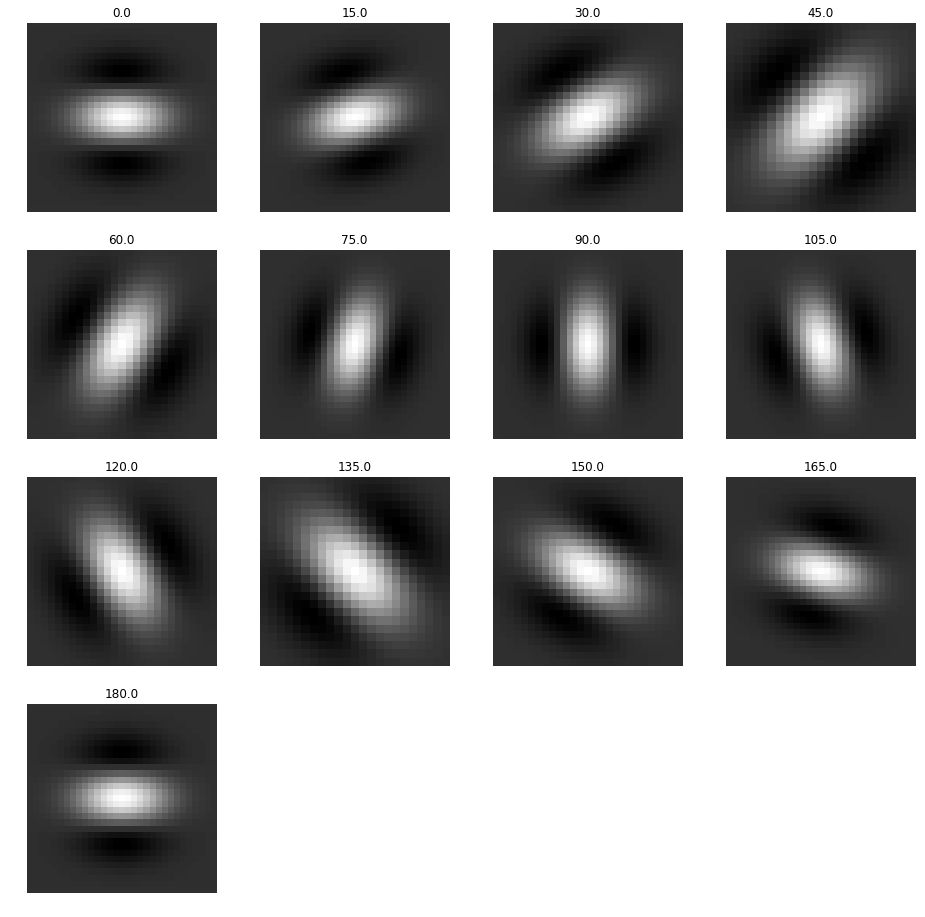

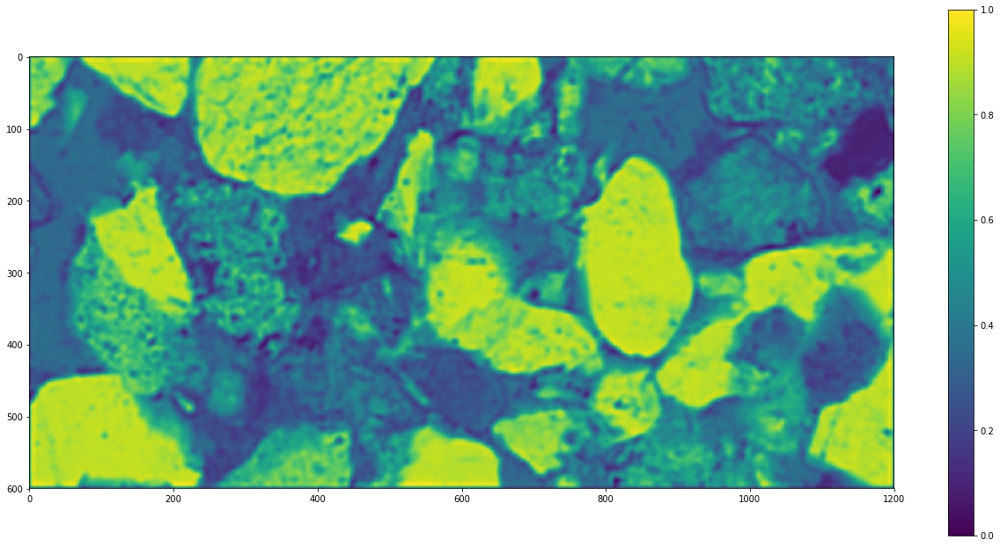

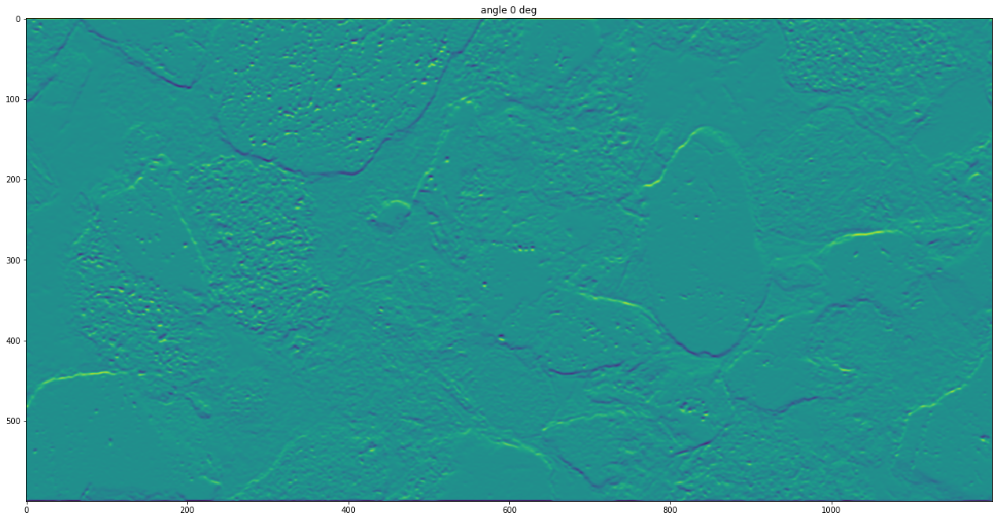

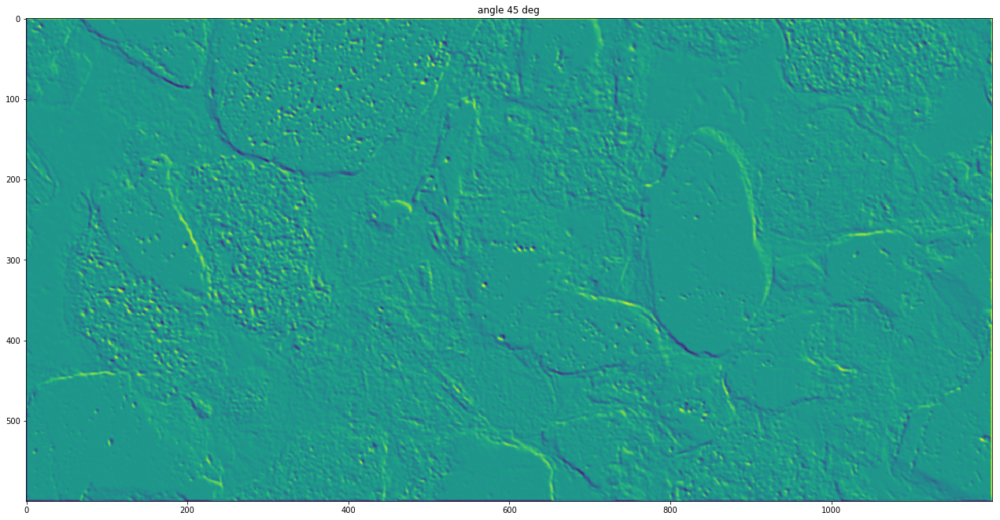

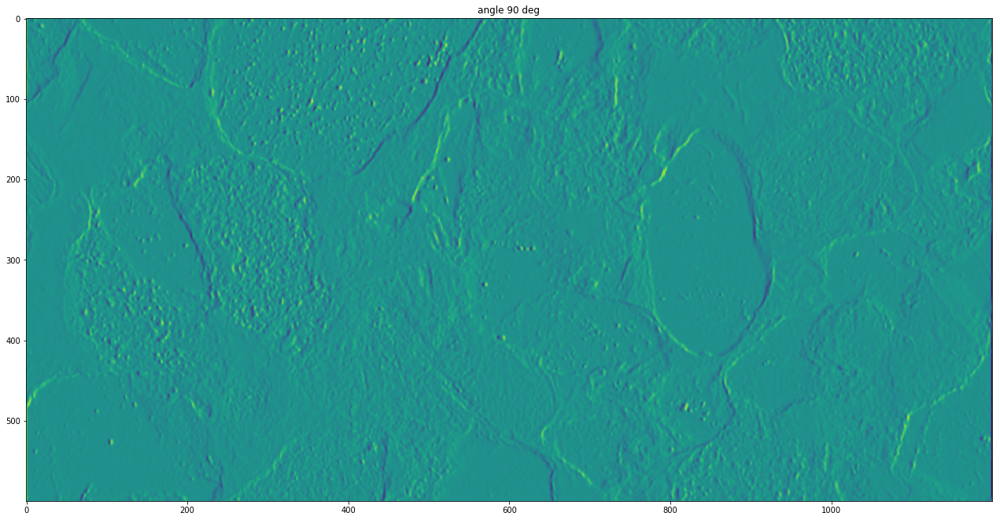

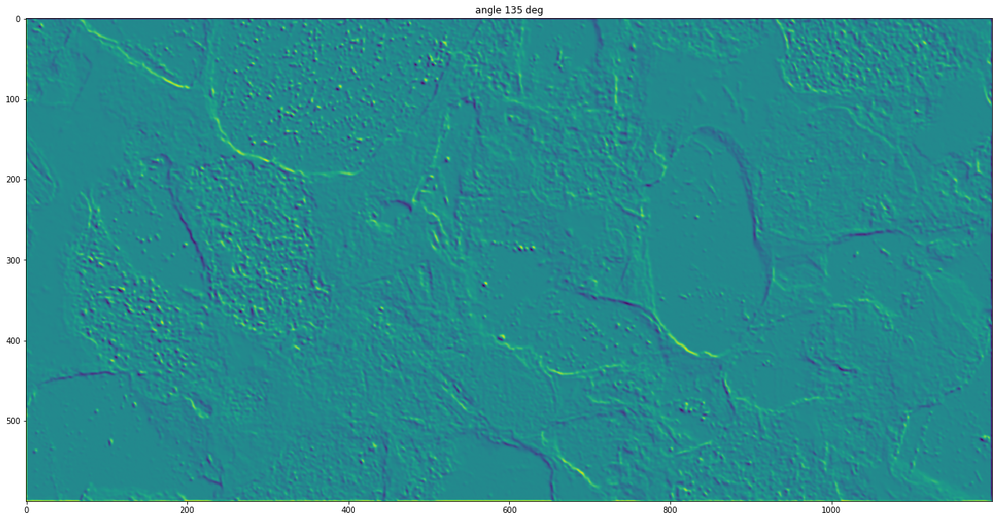

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal as sig
from tools import get_img

class Image_Filters:
    """
    A class simply to hold all image filters for more elegant code
    """
    
    def __init__(self):
        self.img_store = {}
        return
    
    # complex filters
    Sobel_0_3 = np.array([[-1, 0, 1],
                         [ -2, 0, 2],
                         [ -1, 0, 1]])
    Sobel_45_3 = np.array([[0, 1, 2],
                          [-1, 0, 1],
                          [-2,-1, 0]])
    Sobel_0_5 = np.array([[1, 2, 3, 2, 1],
                         [ 2, 3, 5, 3, 2],
                         [ 0, 0, 0, 0, 0],
                         [-2,-3,-5,-3,-2],
                         [-1,-2,-3,-2,-1]])
    Sobel_45_5 = np.array([[0, 2, 3, 2, 1],
                          [-2, 0, 3, 5, 2],
                          [-3,-3, 0, 3, 3],
                          [-2,-5,-3, 0, 2],
                          [-1,-2,-3,-2, 0]])
    Sobel_90_3 = Sobel_0_3.T
    Sobel_135_3 = Sobel_45_3.T
    Sobel_90_5 = Sobel_0_5.T
    Sobel_135_5 = Sobel_45_5.T
    Laws_L5 = np.array([1,4,6,4,1])
    Laws_E5 = np.array([-1,-2,0,2,1])
    Laws_S5 = np.array([-1,0,2,0,-1])
    Laws_W5 = np.array([-1,2,0,-2,1])
    Laws_R5 = np.array([1,-4,6,-4,1])

    
    def avg(self, size):
        return np.ones([size, size]) / (size*size)
    
    
    def laplacian_8(self, size):
        assert size%2==1, 'size must be odd'
        lap = np.ones([size, size])
        i = int(size/2)
        lap[i, i] = 1 - size*size
        return lap

    
    def gabor_fn(self, sigma, theta, Lambda, gamma=1., psi=0.):
        """
        Code from https://en.wikipedia.org/wiki/Gabor_filter#cite_note-8
        sigma: std of the gaussian
        theta: angle of the sinasoid in 2d
        Lambda: sinasoid wavelength
        psi: phase ofset of the sinasoid
        gamma: elpisive factor in the gaussian
        """
        sigma_x = sigma
        sigma_y = float(sigma) / gamma

        # Bounding box
        nstds = 3 # Number of standard deviation sigma
        xmax = max(abs(nstds * sigma_x * np.cos(theta)),
                   abs(nstds * sigma_y * np.sin(theta)))
        xmax = np.ceil(max(1, xmax))
        ymax = max(abs(nstds * sigma_x * np.sin(theta)),
                   abs(nstds * sigma_y * np.cos(theta)))
        ymax = np.ceil(max(1, ymax))
        xmin = -xmax
        ymin = -ymax
        (y, x) = np.meshgrid(np.arange(ymin, ymax + 1),
                             np.arange(xmin, xmax + 1))

        # Rotation 
        x_theta = x * np.cos(theta) + y * np.sin(theta)
        y_theta = -x * np.sin(theta) + y * np.cos(theta)

        gauss = np.exp(-(x_theta**2 / sigma_x**2 + y_theta**2 / sigma_y**2) / 2)
        trig = np.cos(2 * np.pi / Lambda * x_theta + psi)
        return gauss*trig
    
    
    def gabor_bank(self, n_theta, sigma, Lambda, gamma=1., psi=0.,
                   verbose=False):
    
        angs = np.linspace(0, 180, n_theta)
        filt_bank = [self.gabor_fn(sigma, np.deg2rad(ang), Lambda, gamma, psi)
                     for ang in angs]

        if verbose:
            x = 4
            y = int(n_theta/x) + 1
            fig, axs = plt.subplots(y, x, figsize=[16, 16])
            for filt, ax, ang in zip(filt_bank,
                                     axs.ravel()[:n_theta],
                                     angs):
                ax.imshow(filt, cmap='gray')
                ax.set(title=ang)
                ax.axis('off')
            
            # remove unused axis
            for ax in axs.ravel()[n_theta:]:
                fig.delaxes(ax)
                
        return filt_bank
    
    
    def apply_bank(self, filt_bank, grey_img, normed=True, verbose=False):
        output = np.zeros_like(grey_img)
        for filt in filt_bank:
            output += sig.convolve2d(grey_img, filt, mode='same')
               
        if normed:
            output -= output.min()
            output /= output.max()
        
        if verbose:
            fig, ax = plt.subplots(figsize=[22, 11])
            col = ax.imshow(output)
            plt.colorbar(col)
            
        return output
    
    
    def mask_outine(self, mask, size=3):
        """
        Take a 2d mask and use a laplacian convolution to find the segment 
        outlines for plotting. Option decides if all directions are to be
        included 'full' or just horizontal and vertical ones 'edge'
        """    
        conv = sig.convolve2d(mask, self.laplacian_8(size), mode='valid')
        conv = np.pad(conv, 1, 'edge') # ignore edges
        return 1. - np.isclose(conv, 0) # not zero grad (i.e. an edge)
    
    
    def sobel_edge_detection(self, grey_img, verbose=False):
        """
        Sobel edge detection convolution in 4 diretions returning a 3d array
        with angles (0, 45, 90, 135) on the final axis.
        """
        assert len(grey_img.shape) == 2, 'grey_img must be 2d'
        
        zeros = np.zeros_like(grey_img)
        edge_det = np.dstack([zeros, zeros, zeros, zeros])
        
        for i, filt in enumerate([self.Sobel_0_5, self.Sobel_45_5,
                                  self.Sobel_90_5, self.Sobel_135_5]):
            edge_det[:, :, i] = sig.convolve2d(grey_img, filt, mode='same')

        if verbose:
            for i in range(4):
                plt.figure(figsize=[22,22])
                plt.imshow(edge_det[:,:,i])
                plt.title('angle ' + str(i*45) + ' deg')
                
        return edge_det
    
         
    def rgba(self, mask, color='r', opaqueness=1):
        "Take a 2d mask and return a 4d rgba mask for imshow overlaying"
        
        # create the transparent mask
        zeros = np.zeros_like(mask)
        rgba = np.dstack([zeros, zeros, zeros, mask*opaqueness])
        
        # set the correct color channel
        i = ['r', 'g', 'b'].index(color)
        rgba[:, :, i] = mask
            
        return rgba
    
    
    def laws_texture_filters(self, size):
        
        filts = []
        arrs = [self.Laws_L5, self.Laws_E5, self.Laws_S5,
                self.Laws_W5, self.Laws_R5]
        arrs = [np.repeat(arr, size) for arr in arrs]
        
        for arr1 in arrs:
            for arr2 in arrs:
                filts.append(np.outer(arr1.T, arr2.T))
                
        return filts
    
    
    def laws_texture_features(self, grey_img, size, verbose=False):
        
        assert len(grey_img.shape) == 2, 'image must be grey'
        
        filts = self.laws_texture_filters(size)
        n_filts = len(filts)
        
        output = np.empty([*grey_img.shape, n_filts])
        
        for i, filt in enumerate(filts):
            output[:, :, i] = sig.convolve2d(grey_img, filt, mode='same')
            output[:, :, i] -= output[:, :, i].mean()
            output[:, :, i] -= output[:, :, i].std()
            
            if verbose:
                fig, ax = plt.subplots(figsize=[22,11])
                col = ax.imshow(output[:, :, i])
                plt.colorbar(col)
        
        return output            
        
        
        
if __name__ == '__main__':
    
    # gabor filter example
    IF_obj = Image_Filters()
    bank = IF_obj.gabor_bank(13, 5, 20, gamma=1., verbose=True)
    
    img = get_img('/content/images/TX1_white_cropped.tif')
    grey_img = img.mean(axis=2)
    
    IF_obj.apply_bank(bank, grey_img, verbose=True)

    # sobel_edge_detection example
    IF_obj = Image_Filters()
    
    img = get_img('/content/images/TX1_white_cropped.tif')
    grey_img = img.mean(axis=2)

    IF_obj.sobel_edge_detection(grey_img, verbose=True)

### Recombination Wrapper

In [0]:
class recombination_wrapper():
    
    valid_kwargs = [''] # for validating kwarg input ##############
    
    def __init__(self, img, mask, filts=None, **kwargs):
        
        # validate image and mask
        assert img.shape[:2] == mask.shape, \
            'image and mask must have same x,y dimensions'
        assert len(img.shape) == 3 and img.shape[2] == 3, \
            'image must be in shape x, y, rgb'
        
        # set tuneable parameters
        self._init_params(**kwargs)
        
        # store input arrays
        self.img = img
        self.grey_img = img.mean(axis=2)
        self.orig_mask = mask
        self.work_mask = mask.copy()
        self._ydim, self._xdim = mask.shape
        
        # create derived arrays
        if filts == None:
            self.filts = Image_Filters()
            print("Calcuating filtered images ", end='')
            self.orig_edges = self.filts.mask_outine(mask)
            print(".", end='')
            self.sobel_array = self.filts.sobel_edge_detection(self.grey_img)
            print(".", end='')
            gabor_filts = self.filts.gabor_bank(13, 5, 20, gamma=1.)
            self.gabor_array = self.filts.apply_bank(gabor_filts, self.grey_img)
            print(".", end='')
            self.laws_array = self.filts.laws_texture_features(self.grey_img,
                                                               self._law_size)
            print(".")
        else: # this is to save time during code development 
            self.filts = filts
            self.orig_edges = filts.img_store['orig_edges']
            self.sobel_array = filts.img_store['sobel_array']
            self.gabor_array = filts.img_store['gabor_array']
            self.laws_array = filts.img_store['laws_array']
        
        # create the segment objects
        self.seg_objs = self._create_segments()
        self.seg_directory = dict([(n, n) for n in self.seg_objs.keys()])
        # { original id : merged id }, if key != val the segment was merged
        self._to_merge = []
        
        # placeholder for basic_heirachical_clustering obj
        self.cluster_obj, self.clusters = self._cluster()
        
    
    def _init_params(self, **kwargs):
        """
        Parameters that can be tuned are set here and can be overridden
        by passing in the correct kwarg, giving flexibility without the
        need to significantly complicate later code.
        """
        
        # the number of bins used in binning each color channel
        self._n_color_bins = 10
        
        # the number of bins used in binning the gabor image
        self._n_gabor_bins = 10
        
        # scale the color or gabor features in clustering
        self._color_scale = 1.
        self._gabor_scale = 1.
        self._laws_scale = 1.
        
        # scale of closeness in clustering by texture/color (2nd deriv, std scaled)
        self._cluster_scale = 3.
        
        # the minimum size a segment can be
        self._min_seg_size = 50
        
        # size of the laws texture filters to convolve (x5)
        self._law_size = 1
        
        # threshold for a edge to be considered present (std)
        self._bound_present = 2.
        self._bound_absent = -2
        
        # let keyword arguments override these defaults 
        for key, val in kwargs.items():
            exec('self._' + key + '=' + str(val))
        
    
    def _create_segments(self):
        """
        Initalise the segment objects from the original mask. If a list of
        ids is passed in update then only those segments are recreated
        provided they have not been removed yet
        """
        
        seg_ids = np.unique(self.orig_mask)
        segments = {}
        
        # verbose
        N = len(seg_ids)
        bar = progress_bar(N)
        print('Initalising %i segments' % N)
        
        for n, i in enumerate(seg_ids):
            bar(n) # update progress bar
            
            bool_arr = self.orig_mask==i # segments pixel cords
            cords = np.array(np.where(bool_arr)[::-1]).T
            # [::-1] as np.where returns y, x format
            # T as we want in form (N, 2)
            
            bool_arr = bool_arr * self.orig_edges # segments edge pixels
            edges = np.array(np.where(bool_arr)[::-1]).T
            
            segments[i] = (segment(cords, edges, i, self))
            
        print('\n')
        return segments
    
    
    def _update_segments(self, seg_ids):
        """
        Initalise the segment objects from the original mask. If a list of
        ids is passed in update then only those segments are recreated
        provided they have not been removed yet
        """
                
        # verbose
        N = len(seg_ids)
        bar = progress_bar(N)
        print('Updating %i segments' % N)
        
        for n, _id in enumerate(seg_ids):
            # kill all non_existent segments objects
            if self.seg_directory[_id] != _id:
                del self.seg_objs[_id]
            
            # recreate changed segment objects
            else:
                bool_arr = self.work_mask==_id # segments pixel cords
                cords = np.array(np.where(bool_arr)[::-1]).T
                # [::-1] as np.where returns y, x format
                # T as we want in form (N, 2)

                bool_arr = bool_arr * self.orig_edges # segments edge pixels
                edges = np.array(np.where(bool_arr)[::-1]).T

                self.seg_objs[_id] = (segment(cords, edges, _id, self))
            
            bar(n)

            
        print('\n')
        return 
    
        
    def _merge_segments(self):
        """
        For every pair in the to_merge list set the working mask to replace
        the 2nd id with the 1st one. 
        
        Caution is taken to keep track of who has merged so that merging with
        a segment which has already been merged is handelled appropirately. 
        This is done using the seg_directory.
        
        Any changed segment and its neighbours are tracked in order to only
        update segments which have been changed
        """
        to_recalculate = set()
        
        print('Merging %i segments\n' % len(self._to_merge))
        for seg_id1, seg_id2 in self._to_merge:
            
            # select the up to date ids
            id1 = self.seg_directory[seg_id1]
            id2 = self.seg_directory[seg_id2]
            
            # update the working mask
            self.work_mask[self.work_mask == id2] = id1
            
            # update the segment directory
            for key, val in self.seg_directory.items():
                if val == id2:
                    self.seg_directory[key] = id1
                    
            # track which segments to recalculate
            to_recalculate.update([*self.seg_objs[id1].neighbours, 
                                   *self.seg_objs[id2].neighbours])
        
        # clear the merging list
        self._to_merge = []
        return to_recalculate
    
    
    def _size_scan(self):
        """
        Merge small sections with their largest neighbour 
        """
        
        # identify segements to be merged
        for seg1_id, seg1 in self.seg_objs.items():
                
            if seg1.metric_dict['size'] < self._min_seg_size:
                max_index = np.argmax([self.seg_objs[_id].metric_dict['size']
                                       for _id in seg1.neighbours])
                to_merge_id = seg1.neighbours[max_index]
                self._to_merge.append((to_merge_id, seg1_id))
        
        # merge segments then recalculate
        recalc = self._merge_segments()
        self._update_segments(recalc)
        self.cluster_obj, self.clusters = self._cluster()
        
        
    def _texture_scan(self):
        """
        Scan for adjasent segments to merge if there is no apparent edge
        between them
        """
        
        scanned = []
        
        for seg in self.seg_objs.values():
            for neigh_id in seg.neighbours:
                if neigh_id not in scanned:
                    neigh = self.seg_objs[neigh_id]
                    avg_bound_val = (seg.metric_dict['boundaries_dict'][neigh_id] + 
                                     neigh.metric_dict['boundaries_dict'][seg.id]) / 2
                    if seg.group == neigh.group and not avg_bound_val < self._bound_present:
                        self._to_merge.append((seg.id, neigh_id))
                    
            scanned.append(seg.id)

        # merge segments then recalculate
        recalc = self._merge_segments()
        self._update_segments(recalc)
        self.cluster_obj, self.clusters = self._cluster()
        
        
    def _edge_scan(self):
        
        scanned = []
        
        for seg in self.seg_objs.values():
            for neigh_id in seg.neighbours:
                if neigh_id not in scanned:
                    neigh = self.seg_objs[neigh_id]
                    avg_bound_val = (seg.metric_dict['boundaries_dict'][neigh_id] + 
                                     neigh.metric_dict['boundaries_dict'][seg.id]) / 2
                    if avg_bound_val < self._bound_absent:
                        self._to_merge.append((seg.id, neigh_id))
                    
            scanned.append(seg.id)
            
        # merge segments then recalculate
        recalc = self._merge_segments()
        self._update_segments(recalc)
        self.cluster_obj, self.clusters = self._cluster()
        
        
    def _cluster(self):
        """
        """
        # create the features and the clustering object
        feat_vecs = np.vstack([seg.feat_vec
                               for seg in self.seg_objs.values()])
        obj = basic_heirachical_clustering(feat_vecs)
        
        print('Clustering segments')
        obj.iterate()
        
        cluster = obj.deriv_clustering(scale=self._cluster_scale, plot=False)
        print('\nNumber of clusters %i \n' % len(set(cluster)))
        
        # tell each segment what group it is in
        for grp, seg in zip(cluster, self.seg_objs.values()):
            seg.group = grp
        
        return obj, np.unique(cluster)
    
            
    def plot(self, option='default', ax=None, **kwargs):
        
        # if no axis given create one
        if not ax:
            fig, ax = plt.subplots(figsize=[22, 11])
        
        
        # base options
        if option == 'img':
            ax.imshow(self.img)
            ax.set(title='original image')
            
        elif option == 'img_grey':
            ax.imshow(self.grey_img, cmap='gray')
            ax.set(title='original image greyscaled')
        
        elif option == 'orig_mask':
            ax.imshow(self.orig_mask)
            ax.set(title='original mask')
            
        elif option == 'orig_edges':
            ax.imshow(self.filts.rgba(self.orig_edges, color='r'))
            ax.set(title='original mask outline')
            
        elif option == 'merged_mask':
            ax.imshow(self.work_mask)
            ax.set(title='current merged mask')
            
        elif option == 'merged_edges':
            edges = self.filts.mask_outine(self.work_mask)
            ax.imshow(self.filts.rgba(edges, color='g'))
            ax.set(title='original mask outline')
            
            
        # composite options
        elif option == 'both' or option == 'default':
            self.plot('img', ax=ax)
            self.plot('orig_edges', ax=ax)
            self.plot('merged_edges', ax=ax)
            ax.set(title='pre and post merging edges')
            
        elif option == 'merged':
            self.plot('img', ax=ax)
            self.plot('merged_edges', ax=ax)
            ax.set(title='merged segments')
            
        elif option == 'original':
            self.plot('img', ax=ax)
            self.plot('orig_edges', ax=ax)
            ax.set(title='original segments')
            
            
        # clustering options
        elif option == 'shade_clusters':
            self.plot('img', ax=ax)
            colors = np.random.rand(len(self.clusters)+1, 3)
            rgba = np.zeros([self._ydim, self._xdim, 4])
            for seg in self.seg_objs.values():
                rgba = seg.fill_mask(rgba, color=colors[seg.group])
            ax.imshow(rgba)
            ax.set(title='Texture/Color Clustering')
        
        elif option == 'one_cluster':
            assert 'cluster' in kwargs.keys(), 'must specify which cluster'
            self.plot('img', ax=ax)
            rgba = np.zeros([self._ydim, self._xdim, 4])
            rgba[:, :, 3] = 1
            for seg in self.seg_objs.values():
                if seg.group == kwargs['cluster']:
                    rgba = seg.fill_mask(rgba, alpha=0)
            ax.imshow(rgba)
            
        elif option == 'all_cluster':
            plt.close()
            n_clusters = len(self.clusters)
            y = int(n_clusters/2) + 1
            fig, axs = plt.subplots(y, 2, figsize=[24, 6*y])
            
            for ax, i in zip(axs.ravel()[:n_clusters],
                             self.clusters):
                self.plot('one_cluster', ax=ax, cluster=i)
                ax.set(title='Cluster %i'%i)
            
            for ax in axs.ravel()[n_clusters:]:
                fig.delaxes(ax) # remove unused axis
        
        
        # indevidual segment options
        elif option == 'seg_edge':
            assert 'segment' in kwargs.keys(), "specifiy which segment to plot"
            self.seg_objs[kwargs['segment']].edge_plot(ax=ax)
            
        elif option == 'seg_fill':
            assert 'segment' in kwargs.keys(), "specifiy which segment to plot"
            rgba = np.zeros([self._ydim, self._xdim, 4])
            rgba = self.seg_objs[kwargs['segment']].fill_mask(rgba, alpha=.5)
            ax.imshow(rgba)
            ax.set(title='Segment ' + str(kwargs['segment']))
            
            
        # confidence in the existsence of each edge
        elif option == 'edge_confidence':
            mask = np.full(self.work_mask.shape, np.nan)
            for seg in self.seg_objs.values():
                for neigh_id in seg.neighbours:
                    Xs, Ys = [*seg.edge_dict[neigh_id].T]
                    mask[Ys, Xs] = seg.metric_dict['boundaries_dict'][neigh_id]
                    
            self.plot('img', ax=ax)
            col = ax.imshow(mask, cmap='RdYlGn')
            plt.colorbar(col, fraction=0.046/2, pad=0.04)
            ax.set(title='Confidence of edge existence')
            
        elif option == 'edge_hist':
            plt.close()
            bins = kwargs['bins'] if 'bins' in kwargs.keys() else 10
            confidences = []
            for seg in self.seg_objs.values():
                for val in seg.metric_dict['boundaries_dict'].values():
                    confidences.append(val)
            print(confidences)
            plt.hist(confidences, bins)
            plt.title('Histogram of edge confidences')
            
            
        # option not known
        else:
            print('option not recognised, allowed options are:')
            for s in ('default', 'both', 'merged', 'original', 'img',
                      'img_grey', 'orig_mask', 'orig_edges', 'merged_mask',
                      'merged_edges', 'seg_edge', 'seg_fill',
                      'edge_confidence', 'edge_hist'): 
                print('\t-' + s)
    

### Segment

In [0]:
class segment():
    
    def __init__(self, cords, edges, index, wrapper, **kwargs):
        """
        
        """
        # store the given params and some convinient values
        self.id = index
        self.cords = cords
        self.edges = edges
        self._wrapper = wrapper

        # store this segments group id
        self.group = None
        
        # find which edges are with each segments
        self.edge_dict = self._identify_edges()
        self.neighbours = list(self.edge_dict.keys())
        
        # find this segments metrics
        self.metric_dict, self.feat_vec = self._calculate_metrics()
    
    
    def _identify_edges(self):
        """
        For every edge use the wrapper mask to find what other segments
        share this edge and store them in a dictionary so that all pixels
        on a particular border can be indexed.
        """
        
        # dictionary for neighbour_id:[edge_cordinates]
        edge_dict = {}
        
        for x, y in self.edges:
            adj_cords = self._pixel_neighbours(x, y)
            # indexs backwards as mask has y, x format
            adj_segs = self._wrapper.work_mask[adj_cords[:, 1], adj_cords[:, 0]]
            unique_segs = np.unique(adj_segs)
            
            # store cordinates that boarder each neighbour appropirately
            for i in unique_segs:
                if i != self.id:
                    
                    # if neighbour segment already in edge_dict append to it
                    # else create it as a new entry
                    edge_dict.setdefault(int(i),[]).append((x, y))
                        
        # set every edge entry to an array
        for key, lst in edge_dict.items():
            edge_dict[key] = np.array(lst)

        return edge_dict
    

    def _calculate_metrics(self):
        """
        Calculate various properties of this segment which will be used
        in the merging decision process
        """
        
        mets = {}
        
        # shape feats
        mets['size'] = self.cords.shape[0]
        mets['perimeter'] = self.edges.shape[0]
        
        # color feats
        opts = {'bins':self._wrapper._n_color_bins, 'range':(0.,1.),
                'density':True}
        rgbs = self._wrapper.img[self.cords[:, 1], self.cords[:, 0]]
        mets['color_hist_red'] = np.histogram(rgbs[:, 0], **opts)[0] / self._wrapper._n_color_bins
        mets['color_hist_grn'] = np.histogram(rgbs[:, 1], **opts)[0] / self._wrapper._n_color_bins
        mets['color_hist_blu'] = np.histogram(rgbs[:, 2], **opts)[0] / self._wrapper._n_color_bins
        
        mets['color_avg'] = rgbs.mean(axis=0)
        mets['color_std'] = rgbs.std(axis=0)

        # boundary feats
        mets['boundaries_dict'] = {}
        for n in self.neighbours:
            Xs, Ys = self.edge_dict[n][:, 0], self.edge_dict[n][:, 1]
            lst = [self._wrapper.sobel_array[Ys, Xs, i].mean()**2
                   for i in range(4)] # one for each filter direction
            mets['boundaries_dict'][n] = np.log(np.mean(lst)) #############################
        
        # texture features
        gabs = self._wrapper.gabor_array[self.cords[:, 1], self.cords[:, 0]]
        mets['gabor_hist'] = np.histogram(gabs, bins=self._wrapper._n_gabor_bins,
                                          range=(0.,1.), density=True)[0] / self._wrapper._n_gabor_bins
        mets['gabor_avg'] = gabs.mean()
        mets['gabor_std'] = gabs.std()
        
        laws = self._wrapper.laws_array[self.cords[:, 1], self.cords[:, 0], :]
        mets['laws_avg'] = laws.mean(axis=0)
        mets['laws_stds'] = laws.std(axis=0)
           
        # feature vector
        feat = np.hstack((
#                           mets['color_hist_red'] * self._wrapper._color_scale,
#                           mets['color_hist_grn'] * self._wrapper._color_scale,
#                           mets['color_hist_blu'] * self._wrapper._color_scale,
                          mets['color_avg'] * self._wrapper._color_scale,
                          mets['color_std'] * self._wrapper._color_scale,
#                           mets['gabor_hist'] * self._wrapper._gabor_scale,
                          mets['gabor_avg'] * self._wrapper._gabor_scale,
                          mets['gabor_std'] * self._wrapper._gabor_scale,
#                           mets['laws_avg'] * self._wrapper._laws_scale,
#                           mets['laws_stds'] * self._wrapper._laws_scale
                        ))
            
        return mets, feat
       
        
    def _pixel_neighbours(self, x, y):
        """
        Find the neighbours to the x and y pixel. This method is stored on the
        wrapper as it knows the dimensions of the whole image.
        """
        return np.array([(x_, y_) for x_ in range(x-1, x+2)
                                  for y_ in range(y-1, y+2)
                         if ((x != x_ or y != y_) and   # not the center
                             (0 <= x_ < self._wrapper._xdim) and # not outside x range
                             (0 <= y_ < self._wrapper._ydim))])  # not outside y range
    
    
    def fill_mask(self, arr, color=[], alpha=0.4):
        "build up an rgba mask without large memory consumption"
        
        assert len(arr.shape) == 3, 'arr must be 3d'
        assert arr.shape[-1] == 4, 'arr must have shape (X, Y, 4)'
        
        if len(color) == 0:
                color = np.random.rand(3)
        arr[self.cords[:,1], self.cords[:,0], 0] = color[0]
        arr[self.cords[:,1], self.cords[:,0], 1] = color[1]
        arr[self.cords[:,1], self.cords[:,0], 2] = color[2]
        arr[self.cords[:,1], self.cords[:,0], 3] = alpha
        return arr
    
    
    def edge_plot(self, ax):
        ""        
        for n_id, n_cords in self.edge_dict.items():
            ax.plot(n_cords[:,0], n_cords[:,1], 'x', ms=5, label=n_id)
        ax.legend()
                

## Playground

In [0]:
# Make the image filters now to prevent remaking every time
img = get_img('/content/images/TX1_white_cropped.tif')
grey_img = img.mean(axis=2)
mask = np.loadtxt('masks/white_preprocessed_30_30.txt')
IFO = Image_Filters()

filts.img_store['orig_edges'] = filts.mask_outine(mask)
filts.img_store['sobel_array'] = filts.sobel_edge_detection(grey_img)
gabor_filts = filts.gabor_bank(13, 5, 20, gamma=1.)
filts.img_store['gabor_array'] = filts.apply_bank(gabor_filts, grey_img)
filts.img_store['laws_array'] = filts.laws_texture_features(self.grey_img, 1)
# this is done by the wrapper automatically every time it is initalised unless passed

In [0]:
# parameters that can be set on the wrapper
# # the number of bins used in binning each color channel
# self._n_color_bins = 10

# # the number of bins used in binning the gabor image
# self._n_gabor_bins = 10

# # scale the color or gabor features in clustering
# self._color_scale = 1.
# self._gabor_scale = 1.
# self._laws_scale = 1.

# # scale of closeness in clustering by texture/color
# self._cluster_scale = 1.

# # the minimum size a segment can be
# self._min_seg_size = 50

# # size of the laws texture filters to convolve (x5)
# self._law_size = 1

# # threshold for a edge to be considered present
# self._bound_thresh = 1

In [0]:
comb = recombination_wrapper(img, mask, IFO, cluster_scale=1., color_scale=1., gabor_scale=1.)

Initalising 838 segments
Progress |###################################################| 15.7474 s

Clustering segments
Progress |###################################################| 0.6847 s
Number of clusters 11 



Merging 0 segments

Updating 0 segments


Clustering segments
Progress |###################################################| 0.2747 s
Number of clusters 9 



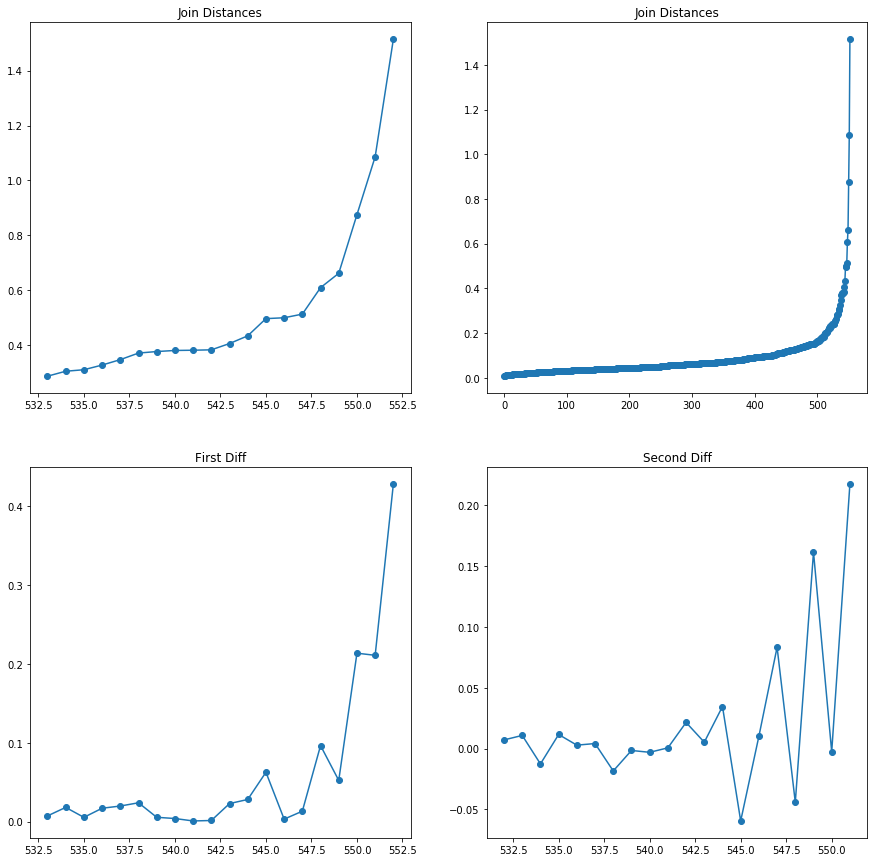

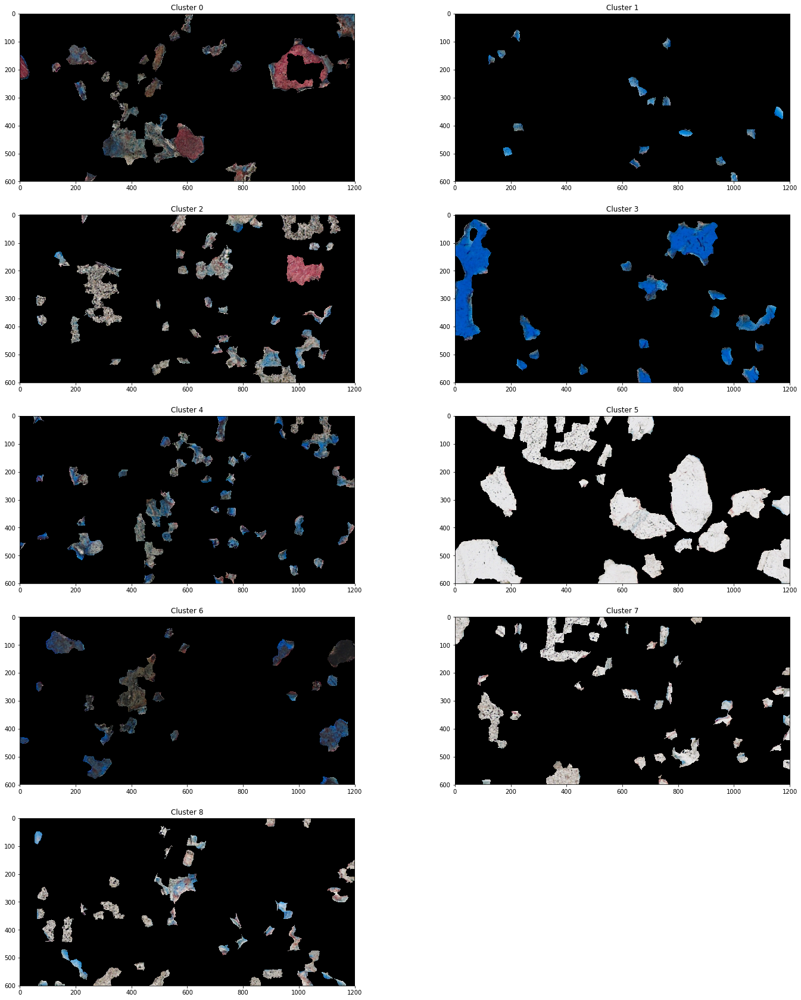

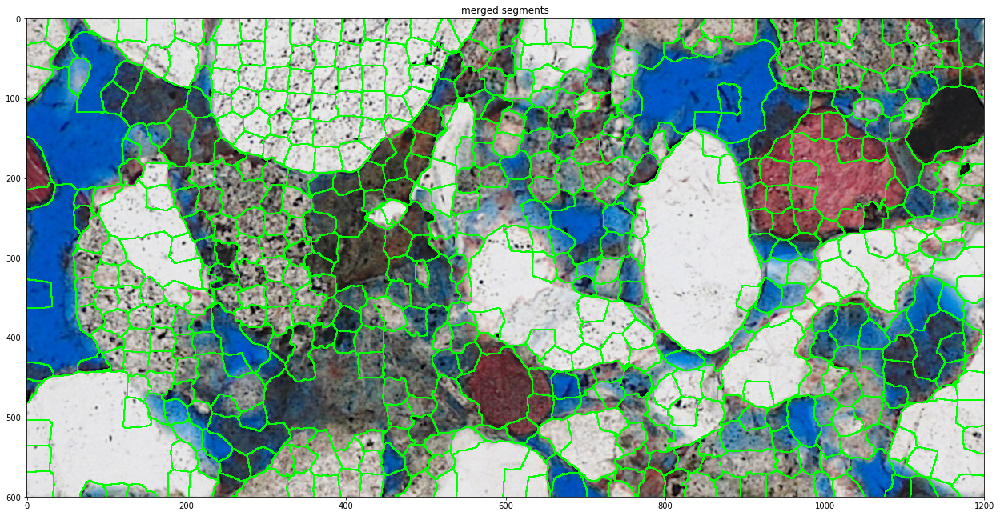

In [0]:
comb._cluster_scale = 1.
comb._size_scan()
comb.cluster_obj.dist_plot('all')
comb.plot('all_cluster')
comb.plot('merged')

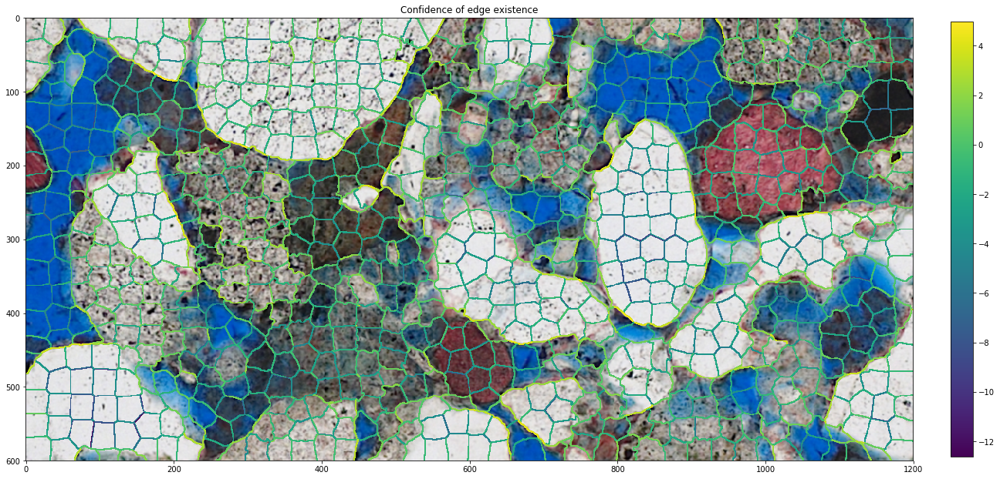

In [0]:
comb.plot('edge_confidence')

[-0.7203489791498134, -1.4455970409233172, -1.0673738885194357, 2.1715947148565253, 0.015457726407758573, 2.557917366620257, 2.695066989934008, 3.1810601833251, 1.0579784078417245, 2.2308827595691474, 2.9011343852602733, -1.4585360119218647, 4.302888696006484, 1.1734132376989481, 3.0125746154159354, -0.9313612567404616, -0.3685668114977775, -0.4318183122283764, -0.9067987833359537, -0.6099007143627243, -2.849500195767638, -4.433730741650816, -0.18944080532027952, -1.0086975012496464, 2.2359085566331443, -0.24426632626641712, -0.7571726353581488, 3.022238627084415, 1.1942545508825895, -1.0375816178365491, 0.07764318856833428, 0.3421610888148205, -0.39057602535333324, 0.8140333009794626, -2.6232013270431893, 0.331434542515849, 1.2385043017219044, -4.158932729315551, -1.5714999908370768, 1.0628281050987058, 1.0772896586935519, -1.4105023203590248, -5.379028118286392, 0.3383926506901558, 0.26549068977004003, 0.8637014149141025, 0.9853331318738241, -2.2220230731542117, -0.6527701740752846, 

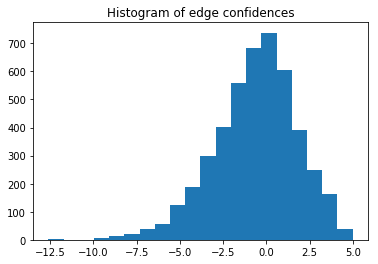

In [0]:
comb.plot('edge_hist', bins=20)

In [0]:
comb._bound_absent = -3
comb._edge_scan()

Merging 100 segments

Updating 487 segments
Progress |###################################################| 8.6274 s

Clustering segments
Progress |###################################################| 0.2773 s
Number of clusters 18 



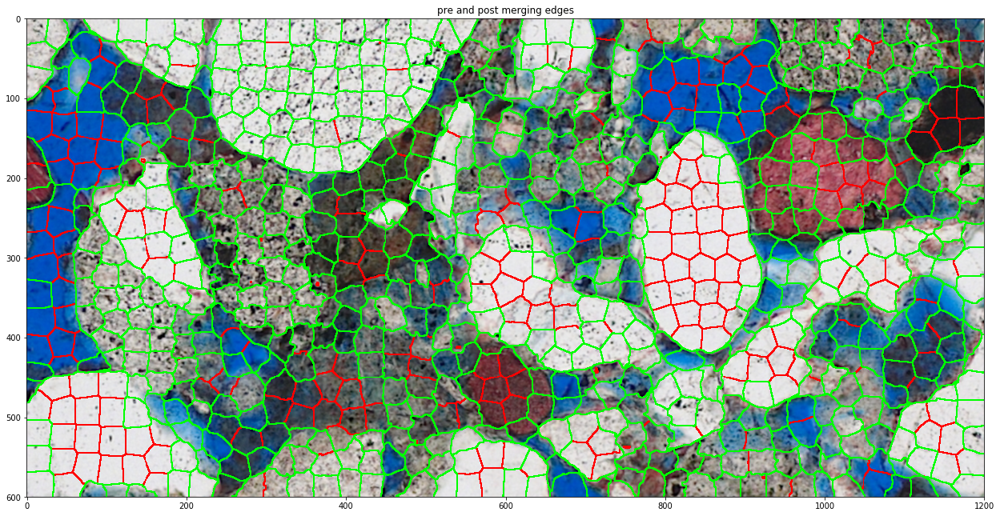

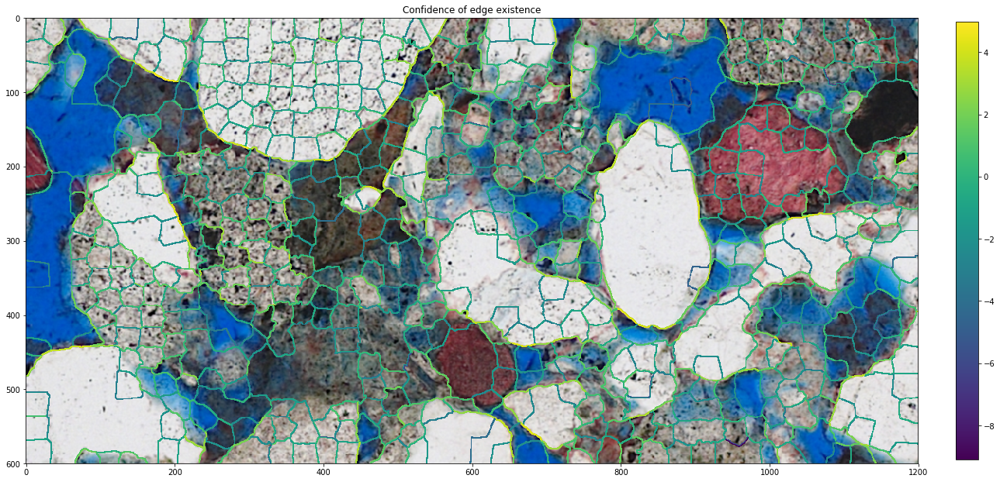

In [0]:
comb.plot('both')
comb.plot('edge_confidence')

In [0]:
# comb._texture_scan()
# comb.plot('all_cluster')
# comb.plot('merged')

In [0]:
# comb._edge_scan()
# comb.plot('all_cluster')
# comb.plot('merged')

Merging 0 segments

Updating 0 segments


Clustering segments
Progress |###################################################| 0.0546 s
Number of clusters 6 

Merging 0 segments

Updating 0 segments


Clustering segments
Progress |###################################################| 0.0536 s
Number of clusters 6 

Merging 0 segments

Updating 0 segments


Clustering segments
Progress |###################################################| 0.0504 s
Number of clusters 6 

Merging 0 segments

Updating 0 segments


Clustering segments
Progress |###################################################| 0.0534 s
Number of clusters 6 

Merging 0 segments

Updating 0 segments


Clustering segments
Progress |###################################################| 0.0547 s
Number of clusters 6 

Merging 0 segments

Updating 0 segments


Clustering segments
Progress |###################################################| 0.0528 s
Number of clusters 6 



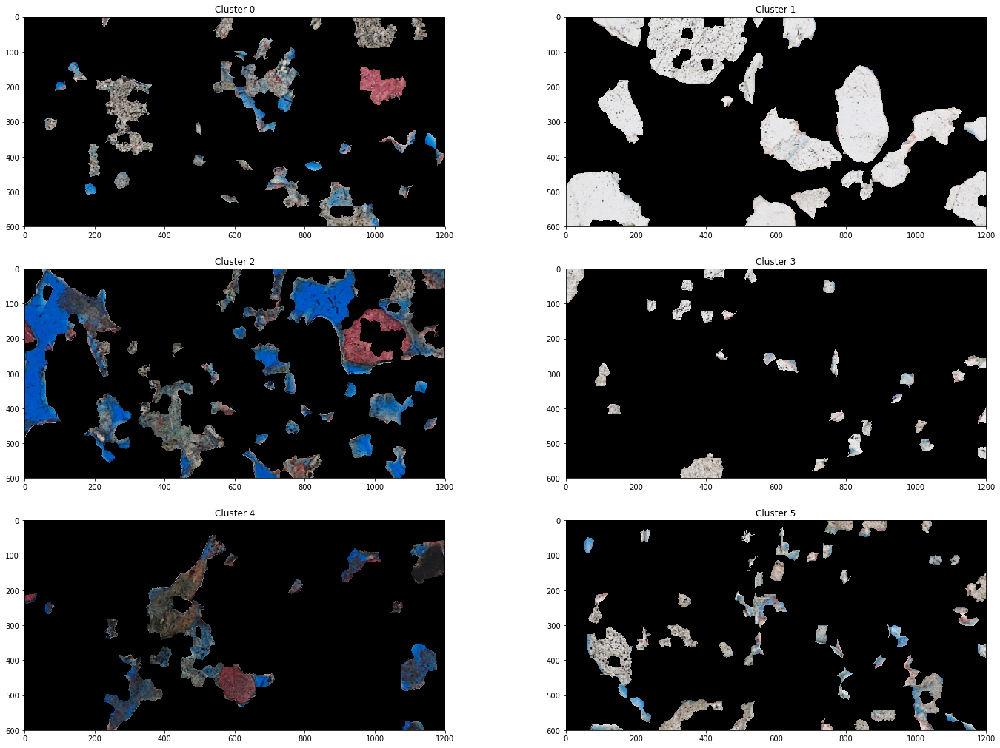

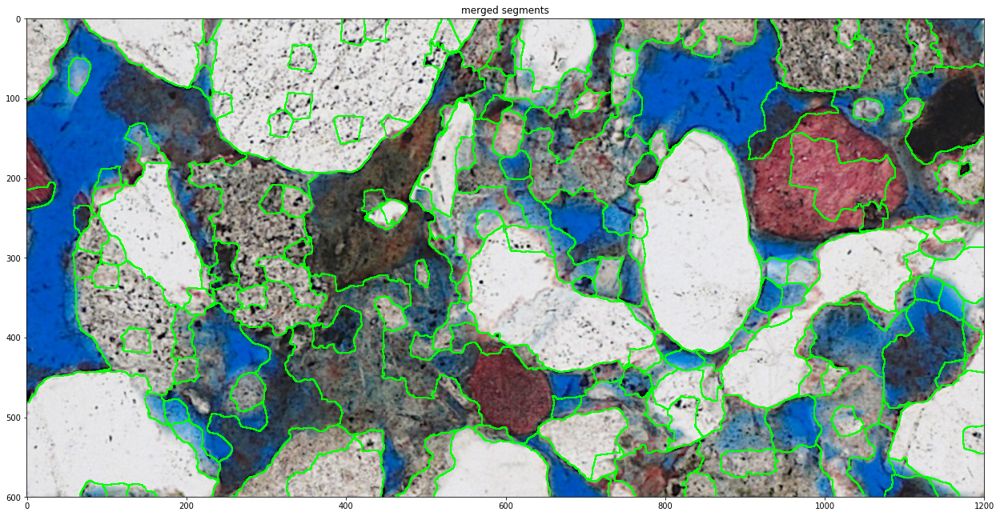

In [0]:
# for _ in range(5):
#     comb._texture_scan()
#     comb._edge_scan()

comb._cluster_scale = 3.

for _ in range(3):
    comb._texture_scan()
    comb._edge_scan()
    
comb.plot('all_cluster')
comb.plot('merged')

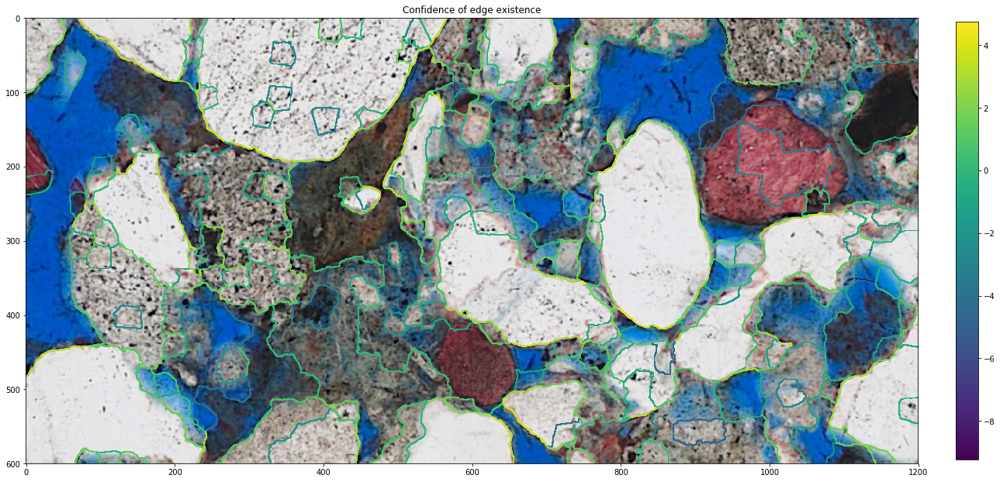

In [0]:
comb.plot('edge_confidence')

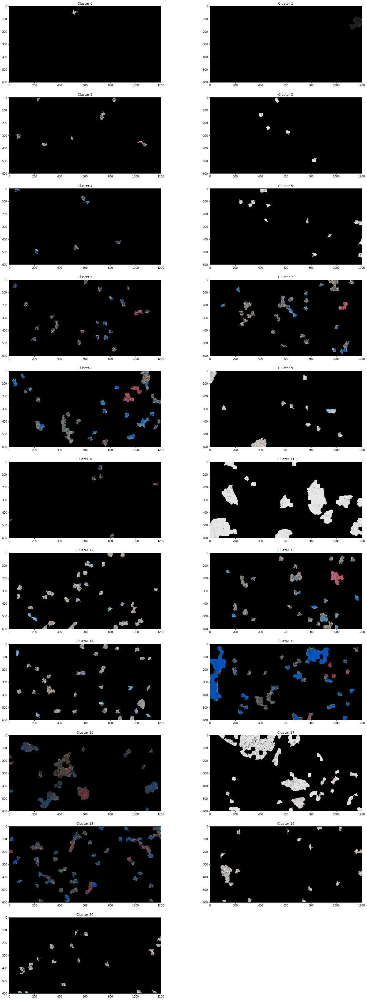

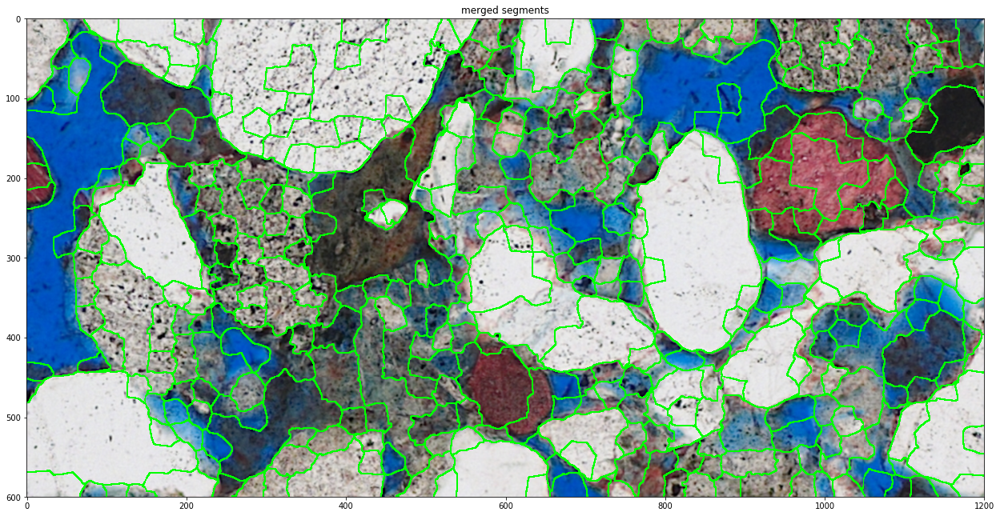

In [0]:
comb.plot('all_cluster')
comb.plot('merged')

In [0]:
import copy as cp
test = cp.deepcopy(comb)

In [0]:
neighs = [len(seg.neighbours) for seg in comb.seg_objs.values()]
sum(neighs)

4586

In [0]:
# comb.plot('edge_confidence')
# comb.plot('all_cluster') # 30, 30
# comb.plot('original')

In [0]:
test._merge_scan()

[]
[(0.0, 1), (0.0, 68), (1.0, 68), (2.0, 40), (2.0, 53), (3.0, 4), (3.0, 57), (4.0, 5), (4.0, 57), (5.0, 6), (5.0, 48), (5.0, 57), (5.0, 76), (6.0, 48), (7.0, 49), (8.0, 9), (8.0, 62), (8.0, 77), (9.0, 10), (9.0, 62), (9.0, 70), (10.0, 11), (10.0, 62), (10.0, 70), (11.0, 12), (11.0, 58), (11.0, 70), (11.0, 78), (12.0, 13), (12.0, 58), (12.0, 63), (13, 14), (13, 54), (13, 63), (14, 15), (14, 54), (15, 16), (15, 45), (15, 54), (15, 73), (16, 17), (16, 45), (17, 18), (19.0, 20), (19.0, 81), (20.0, 41), (20.0, 81), (21.0, 22), (21.0, 75), (22.0, 23), (22.0, 72), (22.0, 75), (23.0, 72), (23.0, 82), (24.0, 25), (24.0, 51), (25.0, 26), (25.0, 55), (25.0, 51), (26.0, 27), (26.0, 55), (26.0, 52), (27.0, 28), (27.0, 42), (27.0, 52), (28.0, 29), (28.0, 42), (29.0, 30), (29.0, 59), (30.0, 59), (30.0, 83), (31.0, 32), (31.0, 64), (32.0, 33), (32.0, 64), (32.0, 65), (33.0, 65), (34, 44), (34, 60), (35, 66), (37.0, 56), (37.0, 80), (38.0, 39), (38.0, 61), (39.0, 61), (39.0, 67), (40.0, 47), (40.0, 5

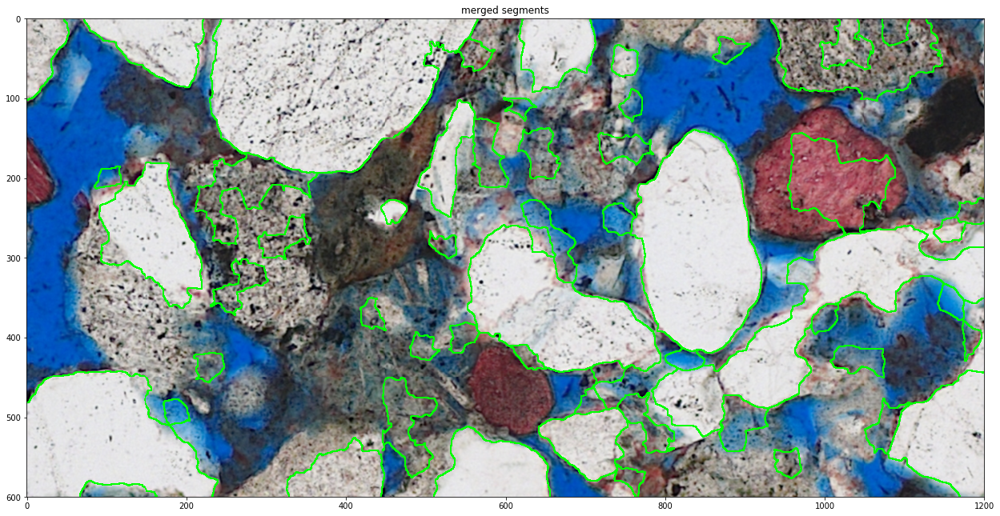

In [0]:
test.plot('merged')

In [0]:
ecomb.plot('all_cluster') # 30, 30
comb.plot('original')

In [0]:
seg = comb.seg_objs[0]


In [0]:
seg.group

5

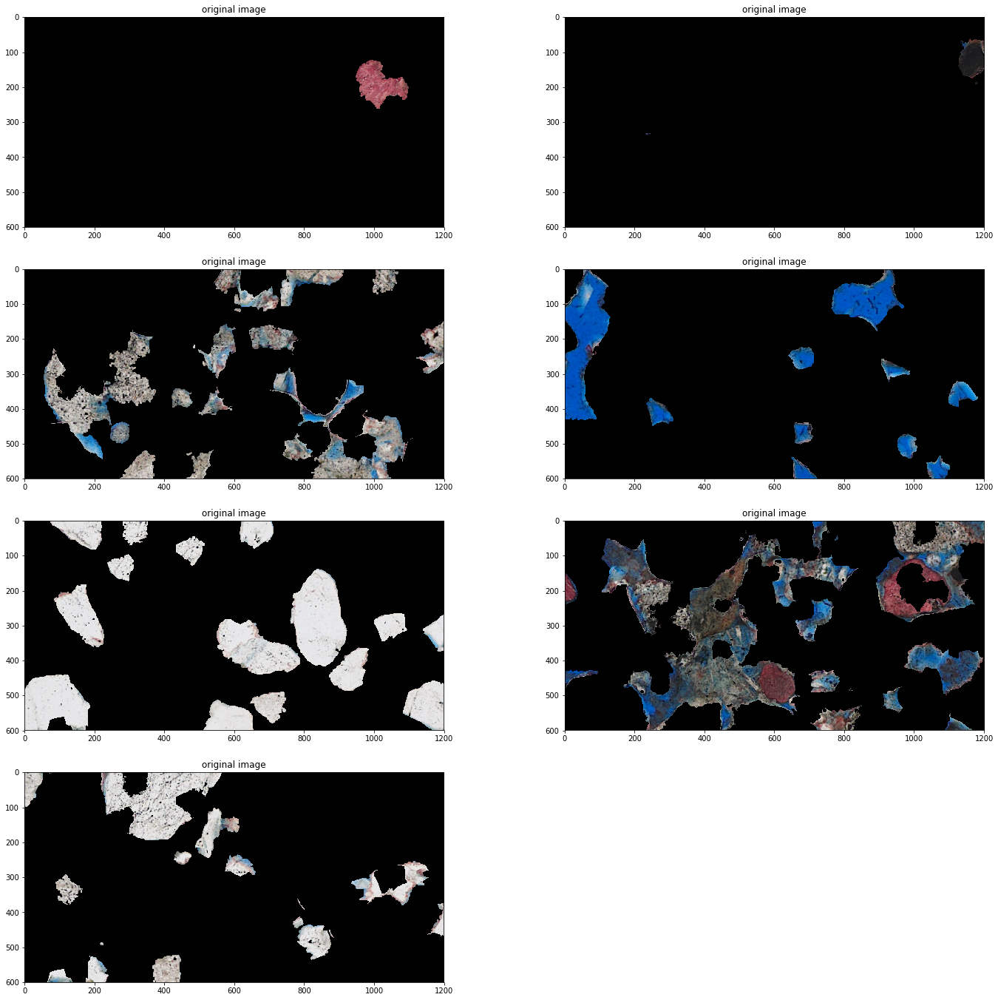

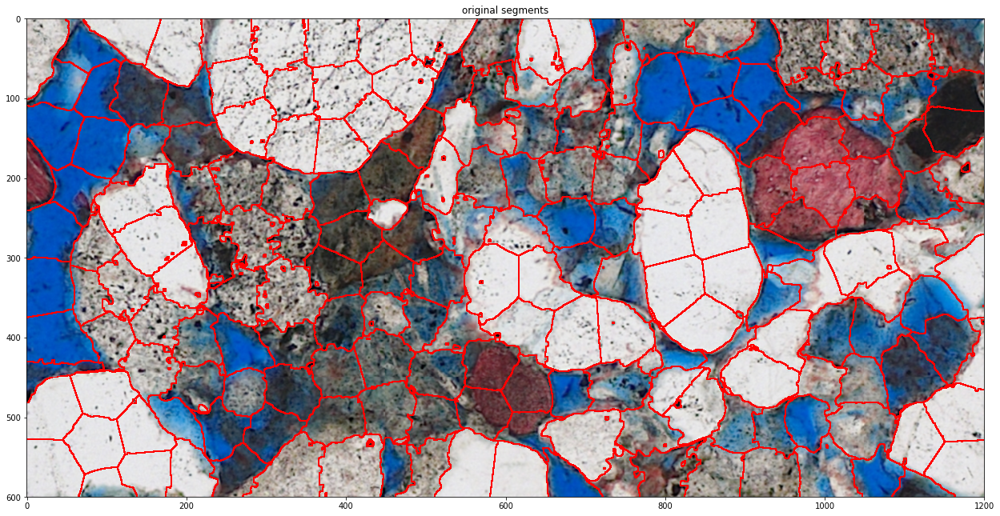

In [0]:
comb.plot('all_cluster') # 60, 60
comb.plot('original')

In [0]:
# comb.seg_objs[0].metric_dict
# comb.seg_objs[0].metric_dict['gabor_hist'].sum() # test
# comb.seg_objs[0].features

array([0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0,
       0, 2, 2, 1, 2, 1, 1, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 1, 0, 2, 0,
       0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0,
       2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0,
       2, 0, 0, 0, 0, 2, 0, 2, 1, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0,
       0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0,
       2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2,
       2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2,
       0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 1, 0, 2, 2,
       0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2,
       0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2,
       2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0,
       2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2,
       2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 1, 2, 2, 0, 2,

In [0]:
comb.plot('original')

## Misc Space i

## Misc Space ii